In [9]:
from sklearn.manifold import SpectralEmbedding
from sklearn.decomposition import PCA
from sklearn.decomposition import TruncatedSVD
from sklearn.metrics import pairwise_distances, silhouette_score, davies_bouldin_score, calinski_harabasz_score
from sklearn.cluster import AgglomerativeClustering, KMeans
import numpy as np
import pandas as pd
from k_means_constrained import KMeansConstrained
import umap

/Users/jakubszafranski/anaconda3/envs/llm_pruning/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


### Code clustering

In [10]:
class ClusteringAlgorithms:
    @staticmethod
    def kmeans_clustering(X: np.ndarray, k: int, random_state: int = 42) -> np.ndarray:
        clf = KMeansConstrained(
            n_clusters=k,
            size_min=X.shape[0] // (k * 1.4),
            size_max=X.shape[0] // (k * 0.6),
            random_state=42
        )
        labels = clf.fit_predict(X)
        return labels

    @staticmethod
    def agglomerative_clustering(X: np.ndarray, k: int, random_state: int = 42) -> np.ndarray:
        agg_clustering = AgglomerativeClustering(n_clusters=k, linkage='ward')
        labels = agg_clustering.fit_predict(X)
        return labels

class DimensionalityReduction:    
    @staticmethod
    def spectral_embedding(X: np.ndarray, n_components: int, random_state: int = 42) -> np.ndarray:
        spectral = SpectralEmbedding(n_components=n_components, random_state=random_state)
        return spectral.fit_transform(X)
    
    @staticmethod
    def pca(X: np.ndarray, n_components: int, random_state: int = 42) -> np.ndarray:
        pca = PCA(n_components=n_components, random_state=random_state)
        return pca.fit_transform(X)
    
    @staticmethod
    def truncated_svd(X: np.ndarray, n_components: int, random_state: int = 42) -> np.ndarray:
        svd = TruncatedSVD(n_components=n_components, random_state=random_state)
        return svd.fit_transform(X)
    
    @staticmethod
    def umap(X: np.ndarray, n_components: int, random_state: int = 42) -> np.ndarray:
        reducer = umap.UMAP(n_components=n_components, random_state=random_state)
        return reducer.fit_transform(X)


def calculate_medoid_hamming_quality(X: np.ndarray, labels: np.ndarray, metric: str = "hamming") -> float:
    if isinstance(X, pd.DataFrame):
        X = X.to_numpy()
    unique_labels = np.unique(labels)
    cluster_qualities = []
    
    for label in unique_labels:
        # Get points in current cluster
        cluster_mask = labels == label
        cluster_points = X[cluster_mask]
            
        medoid = np.round(np.mean(cluster_points, axis=0)).astype(int)
        
        if metric == "hamming":
            # Calculate hamming distances from medoid to all points in cluster
            hamming_distances = []
            for point in cluster_points:
                hamming_dist = np.mean(point != medoid)
                hamming_distances.append(hamming_dist)
            avg_distance_from_medoid = np.mean(hamming_distances)
            
        elif metric == "dice":
            # Calculate Dice coefficient between medoid and all points in cluster
            dice_coefficients = []
            for point in cluster_points:
                # Calculate Dice coefficient: 2 * |intersection| / (|A| + |B|)
                intersection = np.sum((medoid == 1) & (point == 1))
                sum_cardinalities = np.sum(medoid == 1) + np.sum(point == 1)
                
                if sum_cardinalities == 0:
                    # Both are all zeros, perfect similarity
                    dice_coeff = 1.0
                else:
                    dice_coeff = (2.0 * intersection) / sum_cardinalities
                
                dice_coefficients.append(dice_coeff)
                    
            avg_distance_from_medoid = np.mean(dice_coefficients)
        
        cluster_qualities.append(avg_distance_from_medoid)
    
    return np.mean(cluster_qualities)

import time
def evaluate_clustering_pipeline_old(
    X: np.ndarray, 
    n_dims_list: list[int], 
    n_clusters_list: list[int],
    random_state: int = 42
) -> pd.DataFrame:

    results = []    
    dim_red_methods = {
        # 'pca': DimensionalityReduction.pca,
        # 'spectral': DimensionalityReduction.spectral_embedding,
        # 'svd': DimensionalityReduction.truncated_svd,
        'umap': DimensionalityReduction.umap
    }
    
    clustering_methods = {
        'kmeans': ClusteringAlgorithms.kmeans_clustering,
        # 'agglomerative': ClusteringAlgorithms.agglomerative_clustering
    }
    
    # Process dimensionality reduction methods
    for dim_red_name, dim_red_func in dim_red_methods.items():
        print(f"Processing {dim_red_name}...")
        for n_dims in n_dims_list:
            print(f"|- Reducing dimensions to {n_dims}...")
            X_reduced = dim_red_func(X, n_dims, random_state)

            for n_clusters in n_clusters_list:
                print(f"|--- Clustering into {n_clusters} clusters...")
                for clustering_name, clustering_func in clustering_methods.items():
                    print(f"|----- Using {clustering_name}...")
                    start = time.time()
                    labels = clustering_func(X_reduced, n_clusters, random_state)
                    print(f"|------- Clustering took {round(time.time() - start, 2)} seconds")
                    if len(set(labels)) < 2:
                        print(f"[WARNING] Only one cluster found, skipping silhouette score calculation.")
                        continue
                    print("Calculating the metrics...")
                    start = time.time()
                    sil_euclidean = round(silhouette_score(X_reduced, labels, metric='euclidean'), 4)
                    # sil_davies_bouldin = round(davies_bouldin_score(X_reduced, labels), 4)
                    # sil_calinski_harabasz = round(calinski_harabasz_score(X_reduced, labels), 4)

                    # sil_hamming = round(silhouette_score(X_original, labels, metric='hamming'), 4)
                    # sil_dice = round(silhouette_score(X_original, labels, metric='dice'), 4)

                    # medoid_quality_hamming = round(calculate_medoid_hamming_quality(X_original, labels, metric='hamming'), 4)
                    # medoid_quality_dice = round(calculate_medoid_hamming_quality(X_original, labels, metric='dice'), 4)
                    print(f"|------- Metric calculation took {round(time.time() - start, 2)} seconds")
                    statistics = {
                        'dim_reduction': dim_red_name,
                        'n_dims': n_dims,
                        'clustering': clustering_name,
                        'n_clusters': n_clusters,
                        # 'silhouette_hamming': sil_hamming,
                        # 'silhouette_dice': sil_dice,
                        'silhouette_euclidean': sil_euclidean,
                        # 'davies_bouldin': sil_davies_bouldin,
                        # 'calinski_harabasz': sil_calinski_harabasz,
                        # 'medoid_quality_hamming': medoid_quality_hamming,
                        # 'medoid_quality_dice': medoid_quality_dice,
                        'labels_sizes': np.bincount(labels)
                    }
                    results.append(statistics)
                    print(statistics)

                        
    return pd.DataFrame(results)



def evaluate_clustering_pipeline(
    X: np.ndarray, 
    n_dims_list: list[int], 
    n_clusters_list: list[int],
    random_state: int = 42
) -> pd.DataFrame:

    results = []    
    dim_red_methods = {
        'umap': DimensionalityReduction.umap
    }
    
    clustering_methods = {
        'kmeans': ClusteringAlgorithms.kmeans_clustering,
        # 'agglomerative': ClusteringAlgorithms.agglomerative_clustering
    }

    # helper: compute WCSS manually
    def compute_wcss(X, labels):
        wcss = 0
        for cluster_id in np.unique(labels):
            cluster_points = X[labels == cluster_id]
            centroid = cluster_points.mean(axis=0)
            wcss += np.sum((cluster_points - centroid) ** 2)
        return wcss

    # Process dimensionality reduction methods
    for dim_red_name, dim_red_func in dim_red_methods.items():
        print(f"Processing {dim_red_name}...")
        for n_dims in n_dims_list:
            print(f"|- Reducing dimensions to {n_dims}...")
            X_reduced = dim_red_func(X, n_dims, random_state)

            for n_clusters in n_clusters_list:
                print(f"|--- Clustering into {n_clusters} clusters...")
                for clustering_name, clustering_func in clustering_methods.items():
                    print(f"|----- Using {clustering_name}...")
                    start = time.time()
                    labels = clustering_func(X_reduced, n_clusters, random_state)
                    print(f"|------- Clustering took {round(time.time() - start, 2)} seconds")

                    if len(set(labels)) < 2:
                        print(f"[WARNING] Only one cluster found, skipping silhouette score calculation.")
                        continue

                    print("Calculating the metrics...")
                    start = time.time()
                    sil_euclidean = round(silhouette_score(X_reduced, labels, metric='euclidean'), 4)
                    wcss = compute_wcss(X_reduced, labels)
                    print(f"|------- Metric calculation took {round(time.time() - start, 2)} seconds")

                    statistics = {
                        'dim_reduction': dim_red_name,
                        'n_dims': n_dims,
                        'clustering': clustering_name,
                        'n_clusters': n_clusters,
                        'silhouette_euclidean': sil_euclidean,
                        'wcss': wcss,  # <-- added for elbow method
                        'labels_sizes': np.bincount(labels)
                    }
                    results.append(statistics)
                    print(statistics)

    return pd.DataFrame(results)




### Code getting the data

In [11]:
import pandas as pd

df = pd.read_parquet("/Users/jakubszafranski/Desktop/PWr - TAI/llm pruning/grouping_statistics/grouping_alg/custom_activations_100_rows.parquet", engine="fastparquet")

up_proj_df = df[df.index.str.contains('up_proj')]
index_up = up_proj_df.index

down_proj_df = df[df.index.str.contains('down_proj')]
index_down = down_proj_df.index

def get_layer_splits_percentile_normalized(df, threshold):
    def _transform_col_to_percentiles(df):
        return df.apply(lambda x: x.rank(pct=True) * 100, axis=0)

    def _binarize_df(df, threshold):
        return (df > threshold).astype(int)

    def _split_layers(df, threshold):
        dfs = {}

        for i in range(32):
            df_temp = pd.DataFrame()
            layer_mask = df.index.str.contains(f'_{i}_')
            layer_values = df[layer_mask]
            df_temp = pd.concat([df_temp, pd.DataFrame(layer_values)], axis=0)

            dfs[str(i)] = _binarize_df(_transform_col_to_percentiles(df_temp), threshold)

        return dfs
    

    up_proj_df = df[df.index.str.contains('up_proj')]
    down_proj_df = df[df.index.str.contains('down_proj')]

    return _split_layers(up_proj_df, threshold), _split_layers(down_proj_df, threshold)

threshold_percentile = 70
up_proj_dfs, down_proj_dfs = get_layer_splits_percentile_normalized(df, threshold=threshold_percentile)

### Run

In [5]:
import warnings
warnings.filterwarnings("ignore", category=UserWarning)

In [6]:
layers_count = 4
layers_done = 1
layers_to_concat = []
for layer_index in range(layers_count):
    print(str(layers_done*layers_count+layer_index))
    # layers_to_concat.append(down_proj_dfs[str(layers_done*layers_count+layer_index)])
    layers_to_concat.append(up_proj_dfs[str(layers_done*layers_count+layer_index)])  

X = pd.concat(layers_to_concat, axis=0)
# X = down_proj_dfs['0']
X.shape

4
5
6
7


(57344, 100)

In [7]:
600_000 / 1024, 600_000 / 512, 600_000 / 256, 600_000 / 128

(585.9375, 1171.875, 2343.75, 4687.5)

In [8]:
current_size = X.shape[0]
current_size / 585.9375, current_size / 1171.875, current_size / 2343.75

(97.86709333333333, 48.933546666666665, 24.466773333333332)

In [11]:
single_layer = np.array([4, 5, 6, 7, 8]) # num of clusters for a single layer

results_df = evaluate_clustering_pipeline(
    X=X, 
    n_dims_list=[40],
    n_clusters_list=single_layer * layers_count
)

Processing umap...
|- Reducing dimensions to 40...
|--- Clustering into 16 clusters...
|----- Using kmeans...
|------- Clustering took 153.56 seconds
Calculating the metrics...
|------- Metric calculation took 19.98 seconds
{'dim_reduction': 'umap', 'n_dims': 40, 'clustering': 'kmeans', 'n_clusters': np.int64(16), 'silhouette_euclidean': 0.3188, 'wcss': np.float32(29804.32), 'labels_sizes': array([4763, 3784, 4825, 2560, 4073, 2778, 3085, 3111, 5237, 2778, 3273,
       3248, 5973, 2675, 2560, 2621])}
|--- Clustering into 20 clusters...
|----- Using kmeans...
|------- Clustering took 207.87 seconds
Calculating the metrics...
|------- Metric calculation took 19.06 seconds
{'dim_reduction': 'umap', 'n_dims': 40, 'clustering': 'kmeans', 'n_clusters': np.int64(20), 'silhouette_euclidean': 0.3014, 'wcss': np.float32(25213.531), 'labels_sizes': array([3461, 3869, 3030, 3984, 2459, 2048, 2397, 2048, 2048, 2351, 3372,
       2048, 2170, 4406, 2686, 2499, 3044, 2635, 2341, 4448])}
|--- Clusterin

In [13]:
results_df.head(10)

,dim_reduction,n_dims,clustering,n_clusters,silhouette_euclidean,wcss,labels_sizes
0,umap,40,kmeans,16,0.3188,29804.320312,"[4763, 3784, 4825, 2560, 4073, 2778, 3085, 311..."
1,umap,40,kmeans,20,0.3014,25213.531250,"[3461, 3869, 3030, 3984, 2459, 2048, 2397, 204..."
2,umap,40,kmeans,24,0.2967,22462.246094,"[2351, 2010, 2692, 1706, 2105, 3870, 2518, 284..."
3,umap,40,kmeans,28,0.2751,20237.568359,"[1462, 3093, 2092, 2018, 1782, 1909, 1794, 253..."
4,umap,40,kmeans,32,0.2731,18556.744141,"[2192, 2986, 1853, 1519, 1280, 1280, 1747, 128..."


In [18]:
# result df result df where result df not in result df drop duplicates
results_df.to_excel("clustering_results_k_search_3.xlsx", index=False)

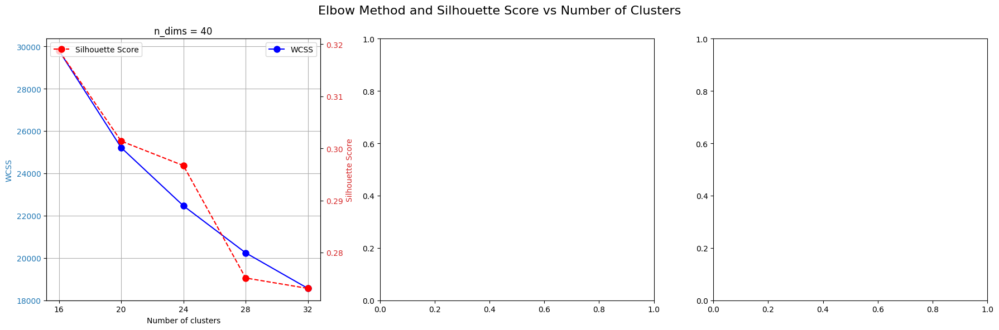

In [14]:
import matplotlib.pyplot as plt
import numpy as np

# Get unique n_dims values
n_dims_values = results_df['n_dims'].unique()

# Create figure with 3 subplots
fig, axes = plt.subplots(1, 3, figsize=(18, 6))
fig.suptitle('Elbow Method and Silhouette Score vs Number of Clusters', fontsize=16)

for i, n_dim in enumerate(n_dims_values):
    # Filter data for current n_dims
    dim_data = results_df[results_df['n_dims'] == n_dim].sort_values('n_clusters')
    
    n_clusters = dim_data['n_clusters'].values
    wcss = dim_data['wcss'].values
    silhouette_scores = dim_data['silhouette_euclidean'].values
    
    ax1 = axes[i]
    
    # Plot WCSS on the left y-axis
    color = 'tab:blue'
    ax1.set_xlabel('Number of clusters')
    ax1.set_ylabel('WCSS', color=color)
    ax1.plot(n_clusters, wcss, 'bo-', markersize=8, label='WCSS')
    ax1.tick_params(axis='y', labelcolor=color)
    ax1.set_xticks(n_clusters)
    ax1.grid(True)
    
    # Create a second y-axis for silhouette score
    ax2 = ax1.twinx()
    color = 'tab:red'
    ax2.set_ylabel('Silhouette Score', color=color)
    ax2.plot(n_clusters, silhouette_scores, 'ro--', markersize=8, label='Silhouette Score')
    ax2.tick_params(axis='y', labelcolor=color)
    
    # Add subplot title
    ax1.set_title(f'n_dims = {n_dim}')
    
    # Add legends
    ax1.legend(loc='upper right')
    ax2.legend(loc='upper left')

plt.tight_layout()
plt.show()

In [ ]:
# Top clusters: 16, 28, ?32?

### Actual clustering

In [22]:
import time
import yaml
import numpy as np
import pandas as pd
from k_means_constrained import KMeansConstrained
import umap
from sklearn.metrics import silhouette_score

with open("/Users/jakubszafranski/Desktop/PWr - TAI/llm pruning/config.yml", "r") as f:
    config = yaml.safe_load(f)
    config = config['grouping']

print(config)

def run_clustering_pipeline(
    X: np.ndarray,
) -> np.ndarray:
    start = time.time()
    print("Starting dimensionality reduction...")
    print(f"Params: {config['dim_reduction']}, components: {config['dim_reduction']['n_components']}")
    reducer = umap.UMAP(n_components=config["dim_reduction"]["n_components"], random_state=config["random_state"])
    X_reduced = reducer.fit_transform(X)
    print(f"Dimensionality reduction completed in {time.time() - start:.2f} seconds. Shape after reduction: {X_reduced.shape}")

    print("Starting clustering...")
    min_size = X.shape[0] // (config["clustering"]["k"] * (1 + config["clustering"]["group_size_deviation"]))
    max_size = X.shape[0] // (config["clustering"]["k"] * (1 - config["clustering"]["group_size_deviation"]))
    print(f"Cluster size constraints: min_size={min_size}, max_size={max_size}")
    print((config["clustering"]["k"] * (1 + config["clustering"]["group_size_deviation"])), (config["clustering"]["k"] * (1 - config["clustering"]["group_size_deviation"])))
    clf = KMeansConstrained(
        n_clusters=config["clustering"]["k"],
        size_min=min_size,
        size_max=max_size,
        random_state=config["random_state"]
    )
    start = time.time()
    labels = clf.fit_predict(X_reduced)
    print(f"Silhouette Score: {silhouette_score(X_reduced, labels, metric='euclidean'):.4f}")
    print(f"Clustering completed in {time.time() - start:.2f} seconds.")
    return labels


import pandas as pd

df = pd.read_parquet("/Users/jakubszafranski/Desktop/PWr - TAI/llm pruning/grouping_statistics/grouping_alg/custom_activations_100_rows.parquet", engine="fastparquet")

up_proj_df = df[df.index.str.contains('up_proj')]
index_up = up_proj_df.index

down_proj_df = df[df.index.str.contains('down_proj')]
index_down = down_proj_df.index

def get_layer_splits_percentile_normalized(df, threshold):
    def _transform_col_to_percentiles(df):
        return df.apply(lambda x: x.rank(pct=True) * 100, axis=0)

    def _binarize_df(df, threshold):
        return (df > threshold).astype(int)

    def _split_layers(df, threshold):
        dfs = {}

        for i in range(32):
            df_temp = pd.DataFrame()
            layer_mask = df.index.str.contains(f'_{i}_')
            layer_values = df[layer_mask]
            df_temp = pd.concat([df_temp, pd.DataFrame(layer_values)], axis=0)

            dfs[str(i)] = _binarize_df(_transform_col_to_percentiles(df_temp), threshold)

        return dfs
    

    up_proj_df = df[df.index.str.contains('up_proj')]
    down_proj_df = df[df.index.str.contains('down_proj')]

    return _split_layers(up_proj_df, threshold), _split_layers(down_proj_df, threshold)

threshold_percentile = config["percentile_threshold"]
print(f"Using percentile threshold: {threshold_percentile}")
up_proj_dfs, down_proj_dfs = get_layer_splits_percentile_normalized(df, threshold=threshold_percentile)

import warnings
warnings.filterwarnings("ignore", category=UserWarning)

def iter_neuron_batches():
    group_size = config["layers_grouped"]
    total_layers = len(up_proj_dfs)
    total_groups = total_layers // group_size

    for group_idx in range(total_groups):
        layer_ids = list(range(group_idx * group_size, (group_idx + 1) * group_size))
        layers_to_concat: list[pd.DataFrame] = []

        for layer_id in layer_ids:
            key = str(layer_id)
            # layers_to_concat.append(down_proj_dfs[key])
            layers_to_concat.append(up_proj_dfs[key])

        X_batch = pd.concat(layers_to_concat, axis=0)
        print(f"Yielding batch for layers {layer_ids} with shape {X_batch.shape}")
        yield X_batch

{'n_samples': 100, 'percentile_threshold': 70, 'layers_grouped': 2, 'random_state': 42, 'dim_reduction': {'name': 'UMAP', 'n_components': 40}, 'clustering': {'name': 'KMeansConstrained', 'k': 16, 'group_size_deviation': 0.4}}
Using percentile threshold: 70


In [ ]:
def process_all_batches() -> pd.DataFrame:
    assignments: list[pd.DataFrame] = []
    for iteration, X_batch in enumerate(iter_neuron_batches()):
        print(f"\nProcessing batch {iteration}...")
        labels = run_clustering_pipeline(X_batch)
        cluster_labels = [f"iter{iteration}_cluster_{label}" for label in labels]

        labeled_df = pd.DataFrame(index=X_batch.index)
        labeled_df["cluster_label"] = cluster_labels

        assignments.append(labeled_df)

    result_df = pd.concat(assignments)
    return result_df

final_assignments = process_all_batches()
final_assignments.head()

Yielding batch for layers [0, 1] with shape (28672, 100)

Processing batch 0...
Starting dimensionality reduction...
Params: {'name': 'UMAP', 'n_components': 40}, components: 40


OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


Dimensionality reduction completed in 36.04 seconds. Shape after reduction: (28672, 40)
Starting clustering...
Cluster size constraints: min_size=1280.0, max_size=2986.0
22.4 9.6
Silhouette Score: 0.3072
Clustering completed in 94.99 seconds.
Yielding batch for layers [2, 3] with shape (28672, 100)

Processing batch 1...
Starting dimensionality reduction...
Params: {'name': 'UMAP', 'n_components': 40}, components: 40
Dimensionality reduction completed in 31.41 seconds. Shape after reduction: (28672, 40)
Starting clustering...
Cluster size constraints: min_size=1280.0, max_size=2986.0
22.4 9.6
Silhouette Score: 0.3338
Clustering completed in 50.56 seconds.
Yielding batch for layers [4, 5] with shape (28672, 100)

Processing batch 2...
Starting dimensionality reduction...
Params: {'name': 'UMAP', 'n_components': 40}, components: 40


In [10]:
final_assignments

,cluster_label
neuron,
up_proj_0_0,iter0_cluster_9
up_proj_0_1,iter0_cluster_1
up_proj_0_2,iter0_cluster_11
up_proj_0_3,iter0_cluster_15
up_proj_0_4,iter0_cluster_12
...,...
up_proj_31_14331,iter15_cluster_14
up_proj_31_14332,iter15_cluster_4
up_proj_31_14333,iter15_cluster_13


In [11]:
final_assignments.to_parquet("clustering_results_up-only_dim40_k16_layers2.parquet")

In [12]:
import numpy as np
import pandas as pd
from collections import defaultdict

def build_cluster_masks(df: pd.DataFrame) -> dict[str, dict[str, dict[str, np.ndarray]]]:
    clusters_by_layer = defaultdict(lambda: defaultdict(lambda: defaultdict(list)))
    layer_sizes = defaultdict(lambda: defaultdict(int))

    for neuron_id, cluster in df["cluster_label"].items():
        parts = neuron_id.split("_")
        layer_type = "_".join(parts[:2])     # "up_proj" / "down_proj"
        layer_idx = parts[2]                 # e.g. "0"
        neuron_idx = int(parts[3])           # e.g. 14335

        clusters_by_layer[layer_type][layer_idx][cluster].append(neuron_idx)
        layer_sizes[layer_type][layer_idx] = max(layer_sizes[layer_type][layer_idx], neuron_idx + 1)

    masks = {}
    for layer_type, layers in clusters_by_layer.items():
        masks[layer_type] = {}
        for layer_idx, cluster_dict in layers.items():
            layer_size = layer_sizes[layer_type][layer_idx]
            mask_dict = {}
            for cluster_label, neuron_indices in cluster_dict.items():
                mask = np.zeros(layer_size, dtype=bool)
                mask[neuron_indices] = True
                if mask.any():
                    mask_dict[cluster_label] = [int(x) for x in mask]
            if mask_dict:
                masks[layer_type][layer_idx] = mask_dict
    return masks

In [13]:
import json

cluster_masks = build_cluster_masks(final_assignments)

print(cluster_masks)

{'up_proj': {'0': {'iter0_cluster_9': [1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0

In [14]:
with open("cluster_masks_up_2l_16c.json", "w") as f:
    json.dump(cluster_masks, f)

In [15]:
def build_cluster_layer_mapping(cluster_masks: dict[str, dict[str, dict[str, np.ndarray]]]) -> dict[str, list[str]]:
    cluster_to_layers = defaultdict(set)
    
    for layer_type, layers in cluster_masks.items():
        for layer_idx, cluster_dict in layers.items():
            for cluster_label in cluster_dict.keys():
                cluster_to_layers[cluster_label].add(layer_idx)
    
    mapping = {
        cluster: sorted(list(layers), key=lambda x: int(x))
        for cluster, layers in cluster_to_layers.items()
    }
    
    return dict(sorted(mapping.items()))

In [16]:
cluster_layer_mapping = build_cluster_layer_mapping(cluster_masks)

In [17]:
with open("cluster_layer_mapping_up_2l_16c.json", "w") as f:
    json.dump(cluster_layer_mapping, f, indent=2)